In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

from zipfile import *

file_name = '/content/gdrive/My Drive/datasets/exp-data.zip'
with ZipFile(file_name, 'r') as f:
  f.extractall()

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [2]:
import tensorflow as tf
from tensorflow.python.client import device_lib
from keras.preprocessing.image import img_to_array, load_img, array_to_img

import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# PATH = 'dataset/exp-data'
PATH = '/content/exp-data'
STORE_NAME = 'dcgan_dragan' # name of folders
store_image_dir = '{}_images'.format(STORE_NAME) # folder to store images for NN

# data variables
IMG_SIZE = 128
CHANNELS = 3
NOISE_DIM = 100

# create numpy array (tensor) for the dataset
train_images = np.ndarray(shape=(6000, IMG_SIZE, IMG_SIZE, CHANNELS), dtype=np.float32)

for i, img in enumerate(os.listdir(PATH)):
    if i >= 6000:
        break
    # using keras image preprocessing package convert the images into a matrix
    image = load_img(PATH + '/' + img)
    x = img_to_array(image)
    
    # add the matrices into the tensor
    train_images[i] = x

train_images = train_images/127.5 - 1 # normalize data to -1 to 1
train_images.shape

Using TensorFlow backend.


(6000, 128, 128, 3)

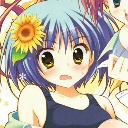

In [3]:
test = array_to_img(train_images[0])
test

## Hyperparameters

In [0]:
# training variables
EPOCHS = 300
BATCH_SIZE = 64

# hyperparameter tuning 
MOMENTUM = 0.8
WEIGHT_INIT_STDDEV =0.02
EPSILON = 0.00005
LEARNING_RATE=0.0002
BETA1 = 0.5
λ = 10

## Building the Generator

In [0]:
def Generator(Z,training):
    with tf.variable_scope('generator',reuse=not training):
        
        # z = tf.placeholder(tf.float32, (None, noise_dim))
        fully_connected = tf.layers.dense(Z, 8*8*1024)
        fully_connected = tf.layers.batch_normalization(fully_connected)
        fully_connected = tf.nn.leaky_relu(fully_connected)
        
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        
#         print(fully_connected.shape)
        
        
        # 8x8x1024 -> 16x16x512
        conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                           filters=512,
                                           kernel_size=[5,5],
                                           strides=[2,2],
                                           padding='SAME', 
                                           kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV), 
                                           name='g_conv1')
        batch1 = tf.layers.batch_normalization(inputs = conv1,
                                               training=training,
                                               epsilon=EPSILON, 
                                               name='g_batch1')
        A1 = tf.nn.leaky_relu(batch1, name='g_A1')
        
#         print(A1.shape)
        
        
        # 16x16x512 -> 32x32x256
        conv2 = tf.layers.conv2d_transpose(inputs=A1,
                                           filters=256,
                                           kernel_size=[5,5],
                                           strides=[2,2],
                                           padding='SAME', 
                                           kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV), 
                                           name='g_conv2')
        batch2 = tf.layers.batch_normalization(inputs = conv2,
                                               training=training,
                                               epsilon=EPSILON, 
                                               name='g_batch2')
        A2 = tf.nn.leaky_relu(batch2, name='g_A2')
        
#         print(A2.shape)
        
        # 32x32x256-> 64x64x128
        conv3 = tf.layers.conv2d_transpose(inputs=A2,
                                           filters=128,
                                           kernel_size=[5,5],
                                           strides=[2,2],
                                           padding='SAME', 
                                           kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV), 
                                           name='g_conv3')
        batch3 = tf.layers.batch_normalization(inputs = conv3,
                                               training=training,
                                               epsilon=EPSILON, 
                                               name='g_batch3')
        A3 = tf.nn.leaky_relu(batch3, name='g_A3')
        
#         print(A3.shape)
        
        # 64x64x128 -> 128x128x64
        conv4 = tf.layers.conv2d_transpose(inputs=A3,
                                           filters=64,
                                           kernel_size=[5,5],
                                           strides=[2,2],
                                           padding='SAME', 
                                           kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV), 
                                           name='g_conv4')
        batch4 = tf.layers.batch_normalization(inputs = conv4,
                                               training=training,
                                               epsilon=EPSILON, 
                                               name='g_batch4')
        A4 = tf.nn.leaky_relu(batch4, name='g_A4')
        
#         print(A4.shape)
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=A4,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding='SAME', 
                                            kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                            name='g_logits')
        out = tf.tanh(logits, name='out')
        return out

## Build the Discriminator

In [0]:
def Discriminator(X, reuse):
    with tf.variable_scope('discriminator', reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=X,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding='SAME', 
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='d_conv1')
        
        batch1 = tf.layers.batch_normalization(conv1,
                                               training=True,
                                               epsilon=EPSILON, 
                                               name='d_batch1')
        A1 = tf.nn.leaky_relu(batch1, name='d_A1')
        
#         print(A1.shape)
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=A1,
                                 filters=128,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding='SAME', 
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='d_conv2')
        batch2 = tf.layers.batch_normalization(conv2,
                                               training=True,
                                               epsilon=EPSILON, 
                                               name='d_batch2')
        A2 = tf.nn.leaky_relu(batch2, name='d_A2')
        
#         print(A2.shape)
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=A2,
                                 filters=256,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding='SAME', 
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='d_conv3')
        batch3 = tf.layers.batch_normalization(conv3,
                                               training=True,
                                               epsilon=EPSILON, 
                                               name='d_batch3')
        A3 = tf.nn.leaky_relu(batch3, name='d_A3')
        
#         print(A3.shape)
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=A3,
                                 filters=512,
                                 kernel_size=[5,5],
                                 strides=[1,1],
                                 padding='SAME', 
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='d_conv4')
        batch4 = tf.layers.batch_normalization(conv4,
                                               training=True,
                                               epsilon=EPSILON, 
                                               name='d_batch4')
        A4 = tf.nn.leaky_relu(batch4, name='d_A4')
        
#         print(A4.shape)
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=A4,
                                 filters=1024,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding='SAME', 
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='d_conv5')
        batch5 = tf.layers.batch_normalization(conv5,
                                               training=True,
                                               epsilon=EPSILON, 
                                               name='d_batch5')
        A5 = tf.nn.leaky_relu(batch5, name='d_A5')
        
#         print(A5.shape)

        flatten = tf.reshape(A5, (-1, 8*8*1024))
        
#         print(flatten.shape)
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

## DRAGAN Loss Function

In [0]:
def get_perturbed_batch(minibatch):
  return minibatch + 0.5 * minibatch.std() * np.random.random(minibatch.shape)

In [9]:
x = tf.placeholder(tf.float32, shape=(None, 128, 128, 3))
x_p = tf.placeholder(tf.float32, shape=(None, 128, 128, 3))
z = tf.placeholder(tf.float32, shape=(None, NOISE_DIM))

g_sample = Generator(z, True)
d_model_real, d_logits_real = Discriminator(x, reuse=False)
d_model_fake, d_logits_fake = Discriminator(g_sample, reuse=True)

real_loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real))
fake_loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake))
d_loss = tf.reduce_mean(real_loss+fake_loss)

# gradient penalty
alpha = tf.random_uniform(shape=[128,1], minval=0, maxval=1.)
differences = x_p - x
interpolates = x + (alpha * differences)
_, d_inter = Discriminator(interpolates, reuse=True)
gradients = tf.gradients(d_inter, [interpolates])[0]
slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), reduction_indices=[1]))
gradient_penalty = tf.reduce_mean((slopes-1.)**2)
d_loss += λ * gradient_penalty

g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

g_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,scope='generator')
d_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,scope='discriminator')

g_step = tf.train.AdamOptimizer(learning_rate=LEARNING_RATE, beta1=BETA1).minimize(g_loss,var_list = g_vars)
d_step = tf.train.AdamOptimizer(learning_rate=LEARNING_RATE, beta1=BETA1).minimize(d_loss,var_list = d_vars)

Instructions for updating:
Use keras.layers.dense instead.
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use keras.layers.batch_normalization instead.
Instructions for updating:
Use keras.layers.conv2d_transpose instead.
Instructions for updating:
Use keras.layers.conv2d instead.
Instructions for updating:
Use tf.cast instead.


## Training

In [0]:
try:
    os.makedirs(store_image_dir)
except FileExistsError:
    pass

try:
    os.makedirs('model')
except FileExistsError:
    pass

def show_samples(epoch, sample_images, dim=(4,4), figsize=(8,8)):
    plt.figure(figsize=figsize)
    for i, img in enumerate(sample_images):
        img = ((img+1.0)*127.5).astype('int')
        image = array_to_img(img)
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(image)
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('{}/epoch {}.png'.format(store_image_dir, epoch))
    plt.show()
    plt.close()

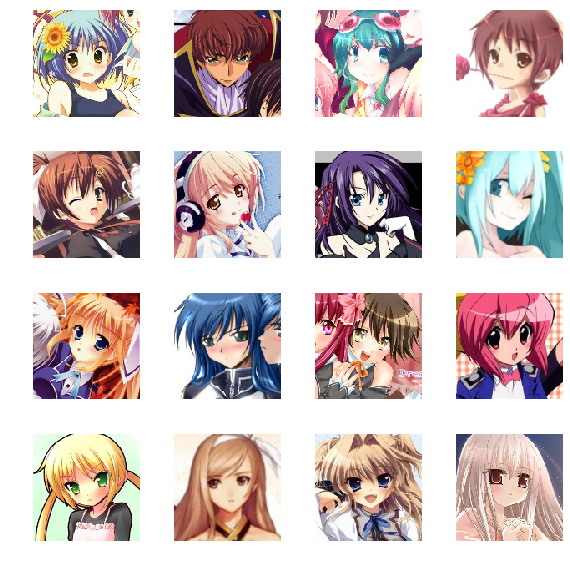

In [11]:
show_samples(0,train_images[:16])

In [0]:
dlosses = []
glosses = []

def train(epochs, batch_size=64,step=1):
    # training of (6000,128,128,3)
    m = train_images.shape[0] # number of training examples
    batch_count = m/batch_size # number of minibatches
    print ('Epochs:', epochs)
    print ('Batch size:', batch_size)
    print ('Batches per epoch:', batch_count)
    
    saver = tf.train.Saver(max_to_keep=4, keep_checkpoint_every_n_hours=2)
    with tf.Session() as sess:
      sess.run(tf.global_variables_initializer())
      
      for e in range(step, epochs+1):
        for _ in tqdm(np.arange(batch_count)):
            # random m samples from gaussian distribution
            z_batch = np.random.uniform(-1, 1, size=(batch_size, NOISE_DIM))
            # getting m training samples
            x_batch = train_images[np.random.randint(0, train_images.shape[0], size=batch_size)]
            x_batch_p = get_perturbed_batch(x_batch)

            _,dloss,penalty = sess.run([d_step, d_loss, gradient_penalty],
                               feed_dict={x: x_batch, x_p: x_batch_p, z: z_batch})

            _,gloss = sess.run([g_step, g_loss],
                               feed_dict={z: z_batch})

        dlosses.append(dloss)
        glosses.append(gloss)

        print('Epoch: {}; D loss: {:.4}; G_loss: {:.4}; penalty: {:.4}'.format(e, dloss, gloss, penalty))

        if e == step or e % 5 == 0:
            z_batch = np.random.uniform(-1, 1, size=(batch_size, NOISE_DIM))
            generated_images = sess.run(g_sample, feed_dict={z: z_batch})
            show_samples(e, generated_images[:16])

        if e % 25 == 0 and e is not step:
            print('Model saved for epoch {}'.format(e))
            saver.save(sess,'model/{}-model'.format(STORE_NAME),global_step=e)

Epochs: 300
Batch size: 64
Batches per epoch: 93.75


100%|██████████| 94/94 [03:16<00:00,  1.96s/it]


Epoch: 1; D loss: 4.395; G_loss: 15.53; penalty: 0.3966


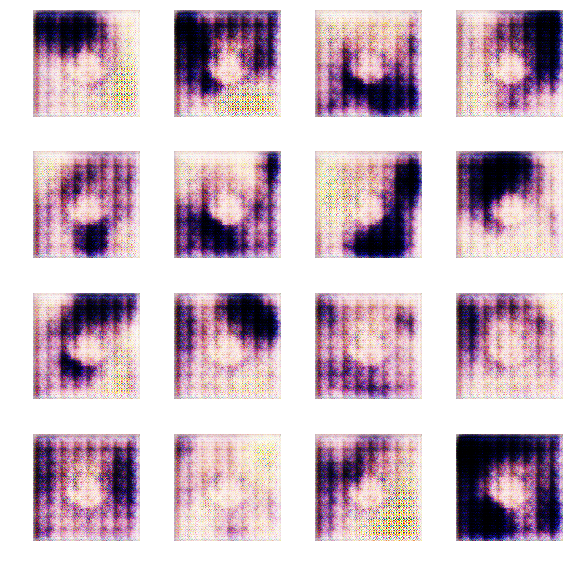

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 2; D loss: 10.6; G_loss: 15.91; penalty: 0.181


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 3; D loss: 3.013; G_loss: 4.844; penalty: 0.1609


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 4; D loss: 2.189; G_loss: 6.633; penalty: 0.1273


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 5; D loss: 4.691; G_loss: 2.084; penalty: 0.104


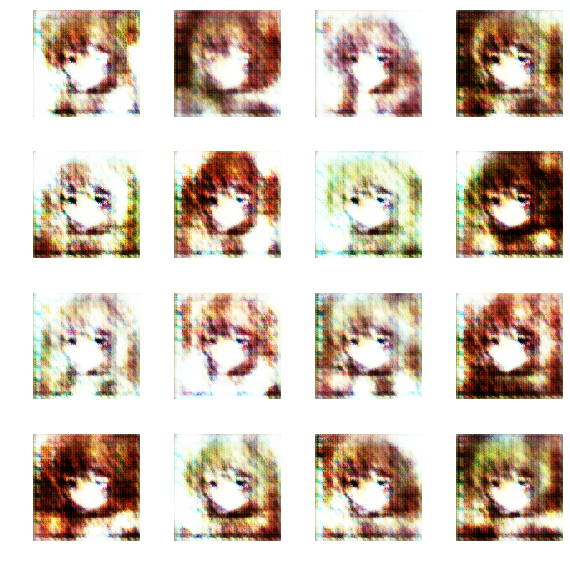

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 6; D loss: 1.349; G_loss: 4.291; penalty: 0.08402


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 7; D loss: 2.871; G_loss: 9.41; penalty: 0.06319


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 8; D loss: 0.8531; G_loss: 4.015; penalty: 0.06102


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 9; D loss: 1.24; G_loss: 3.351; penalty: 0.05177


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 10; D loss: 1.522; G_loss: 3.747; penalty: 0.09594


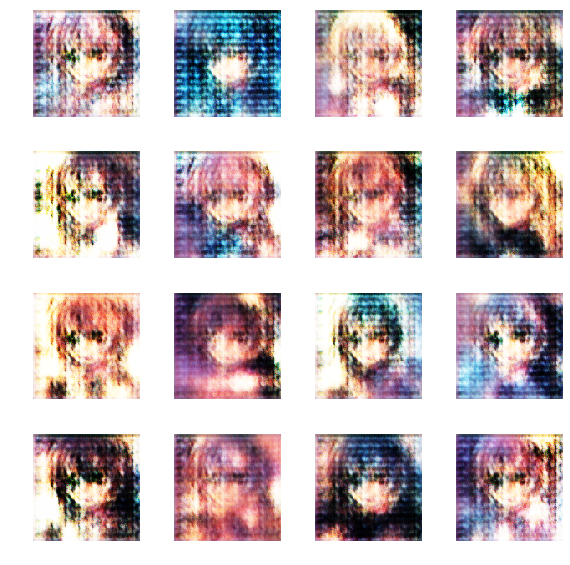

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 11; D loss: 1.077; G_loss: 5.577; penalty: 0.05351


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 12; D loss: 1.648; G_loss: 11.02; penalty: 0.05052


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 13; D loss: 0.8165; G_loss: 4.266; penalty: 0.04389


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 14; D loss: 1.742; G_loss: 10.41; penalty: 0.0455


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 15; D loss: 1.41; G_loss: 11.97; penalty: 0.03679


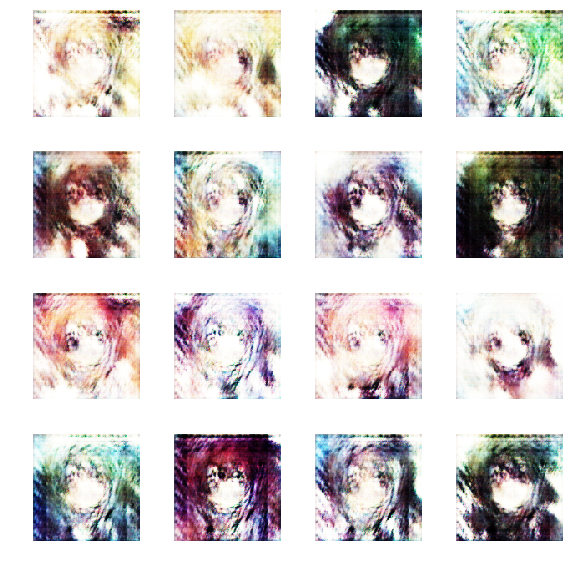

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 16; D loss: 0.5903; G_loss: 4.799; penalty: 0.0375


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 17; D loss: 0.6898; G_loss: 5.273; penalty: 0.04139


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 18; D loss: 0.901; G_loss: 9.715; penalty: 0.03284


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 19; D loss: 1.769; G_loss: 17.49; penalty: 0.03786


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 20; D loss: 0.8008; G_loss: 7.304; penalty: 0.03766


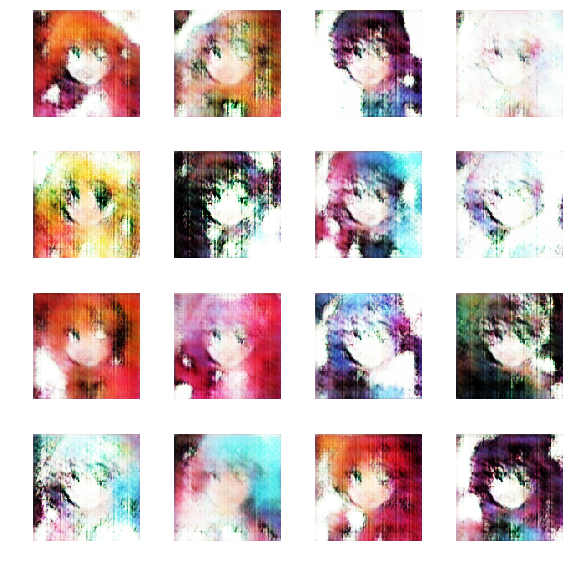

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 21; D loss: 0.586; G_loss: 4.324; penalty: 0.03036


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 22; D loss: 0.4569; G_loss: 5.405; penalty: 0.02822


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 23; D loss: 0.6298; G_loss: 5.576; penalty: 0.04123


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 24; D loss: 0.5232; G_loss: 3.219; penalty: 0.04543


100%|██████████| 94/94 [03:06<00:00,  1.99s/it]


Epoch: 25; D loss: 0.8242; G_loss: 10.08; penalty: 0.02998


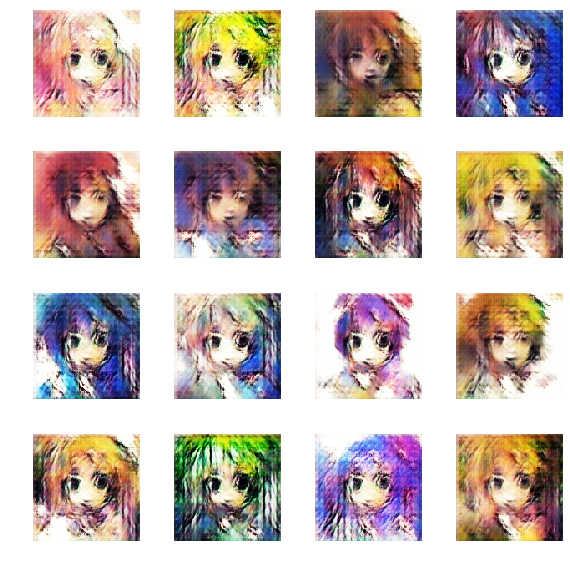

Model saved for epoch 25


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 26; D loss: 0.3548; G_loss: 6.901; penalty: 0.02916


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 27; D loss: 0.3961; G_loss: 6.334; penalty: 0.03029


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 28; D loss: 1.384; G_loss: 13.51; penalty: 0.02895


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 29; D loss: 0.9961; G_loss: 13.99; penalty: 0.02425


100%|██████████| 94/94 [03:05<00:00,  1.99s/it]


Epoch: 30; D loss: 0.9463; G_loss: 5.896; penalty: 0.033


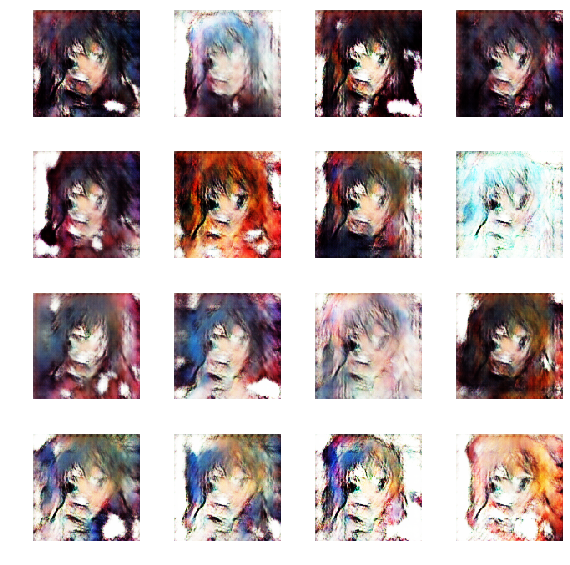

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 31; D loss: 1.701; G_loss: 13.14; penalty: 0.02359


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 32; D loss: 0.6636; G_loss: 8.44; penalty: 0.02357


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 33; D loss: 0.5862; G_loss: 3.92; penalty: 0.03668


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 34; D loss: 0.3011; G_loss: 6.202; penalty: 0.02309


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 35; D loss: 0.4589; G_loss: 7.639; penalty: 0.02811


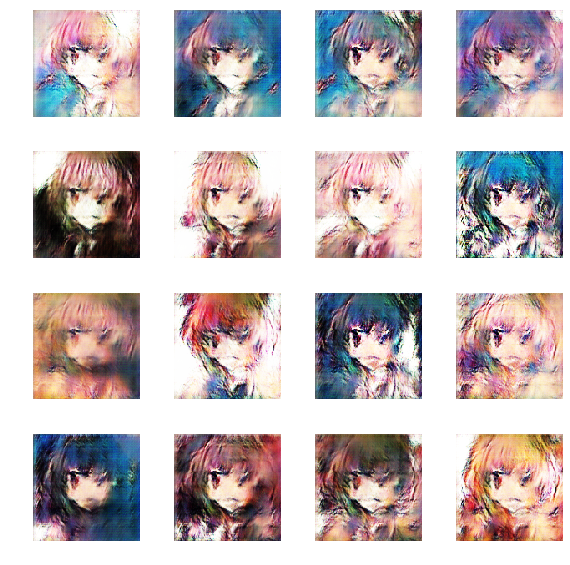

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 36; D loss: 0.2634; G_loss: 6.204; penalty: 0.02222


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 37; D loss: 0.4391; G_loss: 6.247; penalty: 0.02612


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 38; D loss: 0.5041; G_loss: 7.214; penalty: 0.02925


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 39; D loss: 0.2562; G_loss: 6.118; penalty: 0.02247


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 40; D loss: 0.2432; G_loss: 7.175; penalty: 0.02109


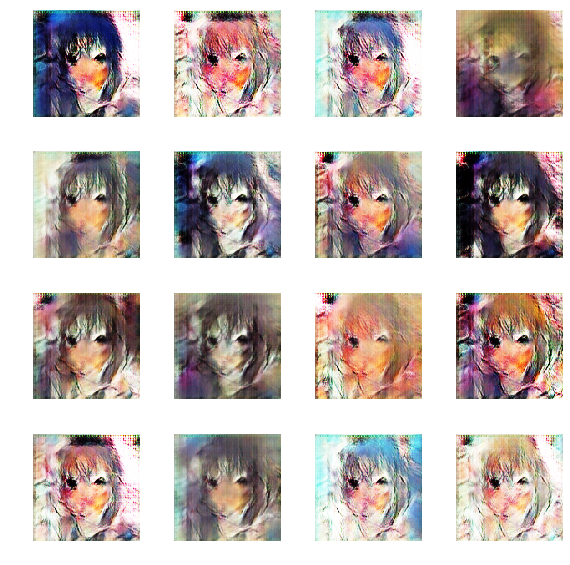

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 41; D loss: 0.5648; G_loss: 10.38; penalty: 0.02862


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 42; D loss: 1.087; G_loss: 5.642; penalty: 0.02468


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 43; D loss: 0.7651; G_loss: 18.72; penalty: 0.0222


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 44; D loss: 0.5581; G_loss: 14.19; penalty: 0.02406


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 45; D loss: 0.7219; G_loss: 20.12; penalty: 0.02298


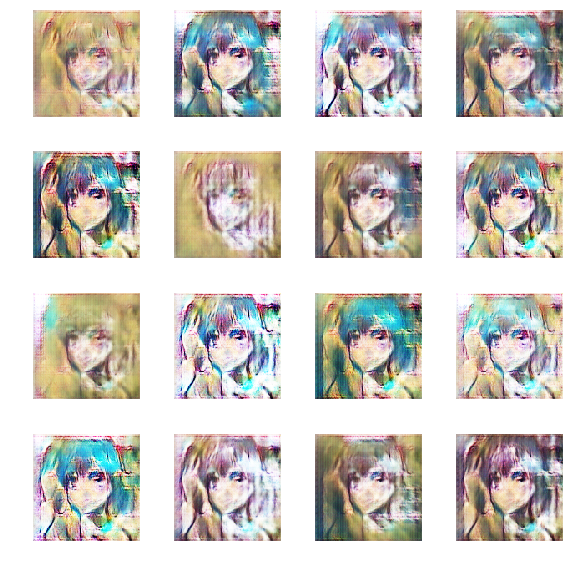

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 46; D loss: 0.4685; G_loss: 9.55; penalty: 0.03336


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 47; D loss: 0.2798; G_loss: 3.677; penalty: 0.02141


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 48; D loss: 0.2791; G_loss: 12.73; penalty: 0.02712


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 49; D loss: 0.5091; G_loss: 7.917; penalty: 0.03403


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 50; D loss: 0.2555; G_loss: 8.436; penalty: 0.01781


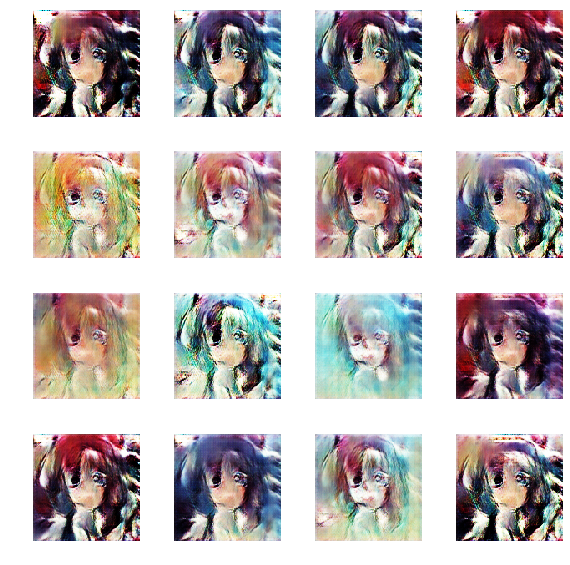

Model saved for epoch 50


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 51; D loss: 0.2783; G_loss: 10.38; penalty: 0.02434


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 52; D loss: 0.7566; G_loss: 12.33; penalty: 0.03031


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 53; D loss: 0.3226; G_loss: 9.601; penalty: 0.0212


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 54; D loss: 0.243; G_loss: 12.75; penalty: 0.01783


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 55; D loss: 0.4399; G_loss: 9.823; penalty: 0.02923


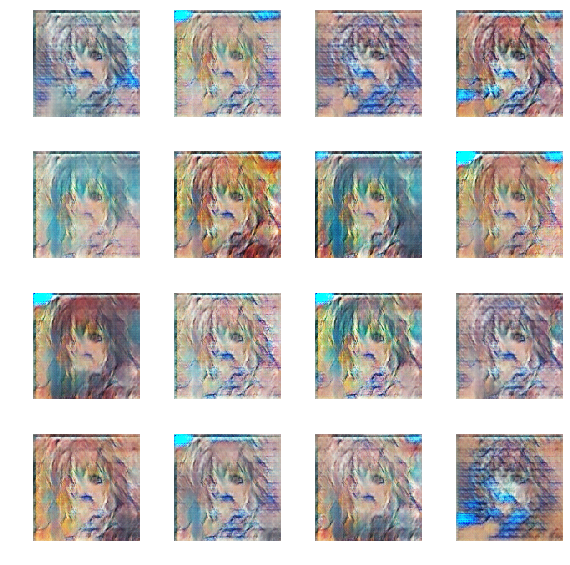

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 56; D loss: 0.4268; G_loss: 15.01; penalty: 0.02148


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 57; D loss: 0.3802; G_loss: 5.935; penalty: 0.02247


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 58; D loss: 0.9783; G_loss: 22.48; penalty: 0.02667


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 59; D loss: 0.3079; G_loss: 9.37; penalty: 0.02011


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 60; D loss: 0.5994; G_loss: 15.15; penalty: 0.0263


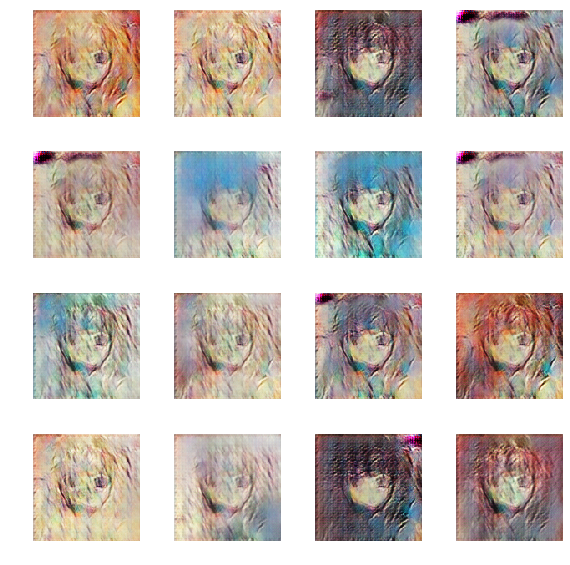

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 61; D loss: 0.2748; G_loss: 8.973; penalty: 0.0213


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 62; D loss: 0.2279; G_loss: 10.44; penalty: 0.02205


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 63; D loss: 0.192; G_loss: 6.954; penalty: 0.01618


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 64; D loss: 0.4955; G_loss: 12.9; penalty: 0.02548


100%|██████████| 94/94 [03:06<00:00,  1.98s/it]


Epoch: 65; D loss: 0.6045; G_loss: 15.5; penalty: 0.02584


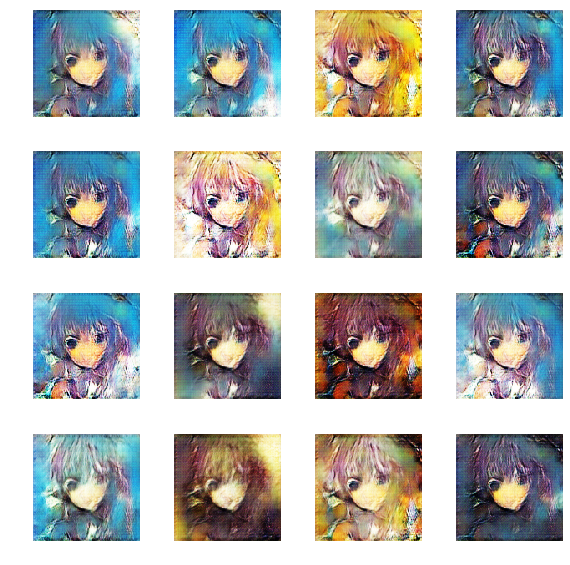

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 66; D loss: 0.3068; G_loss: 12.72; penalty: 0.02326


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 67; D loss: 0.3098; G_loss: 11.16; penalty: 0.02664


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 68; D loss: 0.4291; G_loss: 9.295; penalty: 0.0212


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 69; D loss: 0.216; G_loss: 7.662; penalty: 0.01661


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 70; D loss: 0.3331; G_loss: 11.67; penalty: 0.02301


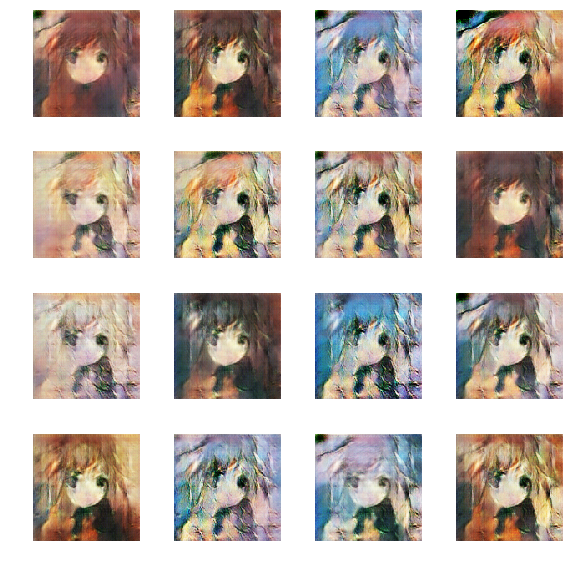

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 71; D loss: 0.2413; G_loss: 10.41; penalty: 0.02141


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 72; D loss: 0.2557; G_loss: 9.463; penalty: 0.0235


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 73; D loss: 0.3101; G_loss: 11.1; penalty: 0.02489


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 74; D loss: 0.1765; G_loss: 10.95; penalty: 0.01527


100%|██████████| 94/94 [03:05<00:00,  1.96s/it]


Epoch: 75; D loss: 0.6512; G_loss: 12.29; penalty: 0.01329


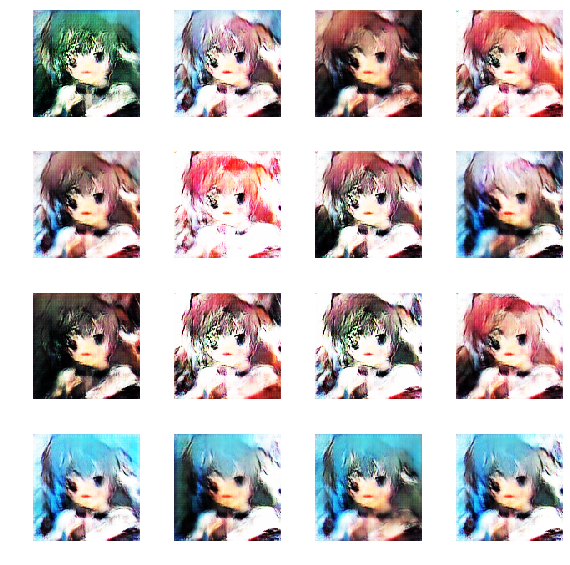

Model saved for epoch 75


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 76; D loss: 0.179; G_loss: 6.25; penalty: 0.01426


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 77; D loss: 0.3763; G_loss: 6.965; penalty: 0.03201


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 78; D loss: 0.9267; G_loss: 21.93; penalty: 0.02147


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 79; D loss: 0.2775; G_loss: 12.41; penalty: 0.01439


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 80; D loss: 0.3347; G_loss: 9.731; penalty: 0.02056


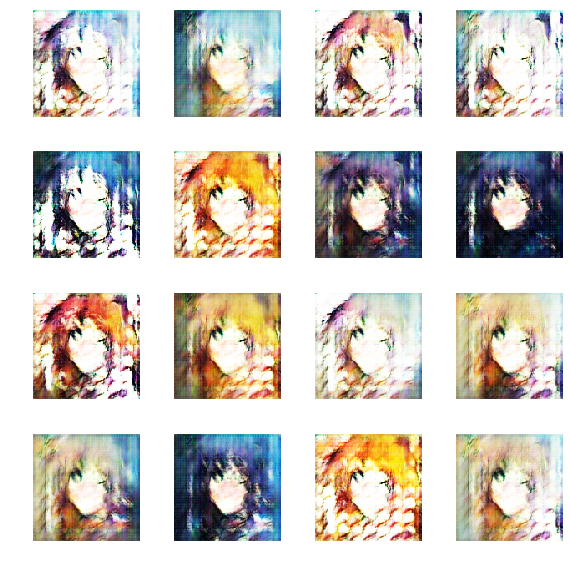

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 81; D loss: 0.5888; G_loss: 8.139; penalty: 0.0547


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 82; D loss: 1.007; G_loss: 11.81; penalty: 0.02351


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 83; D loss: 0.1752; G_loss: 8.314; penalty: 0.01631


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 84; D loss: 0.2976; G_loss: 9.551; penalty: 0.01436


100%|██████████| 94/94 [03:06<00:00,  1.98s/it]


Epoch: 85; D loss: 0.2149; G_loss: 7.005; penalty: 0.01423


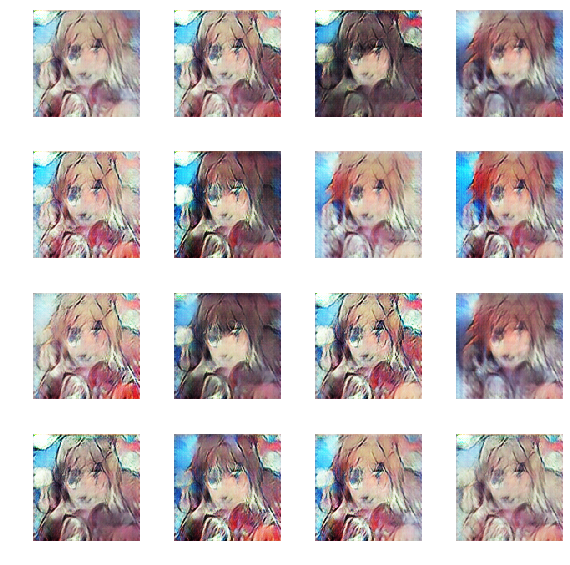

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 86; D loss: 4.109; G_loss: 21.35; penalty: 0.01953


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 87; D loss: 0.1643; G_loss: 8.514; penalty: 0.01421


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 88; D loss: 0.3216; G_loss: 9.386; penalty: 0.02002


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 89; D loss: 0.2485; G_loss: 9.854; penalty: 0.01893


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 90; D loss: 0.1986; G_loss: 7.305; penalty: 0.01605


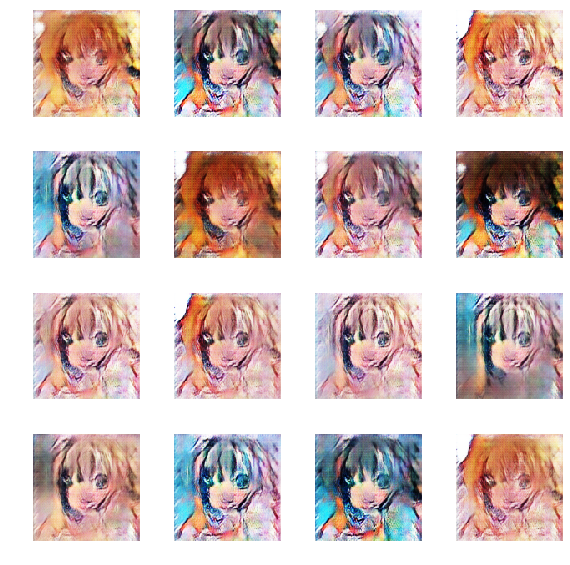

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 91; D loss: 0.725; G_loss: 5.638; penalty: 0.01287


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 92; D loss: 0.2406; G_loss: 11.44; penalty: 0.0149


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 93; D loss: 0.1576; G_loss: 8.919; penalty: 0.01375


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 94; D loss: 0.2537; G_loss: 9.385; penalty: 0.01918


100%|██████████| 94/94 [03:06<00:00,  1.98s/it]


Epoch: 95; D loss: 0.1643; G_loss: 9.121; penalty: 0.01614


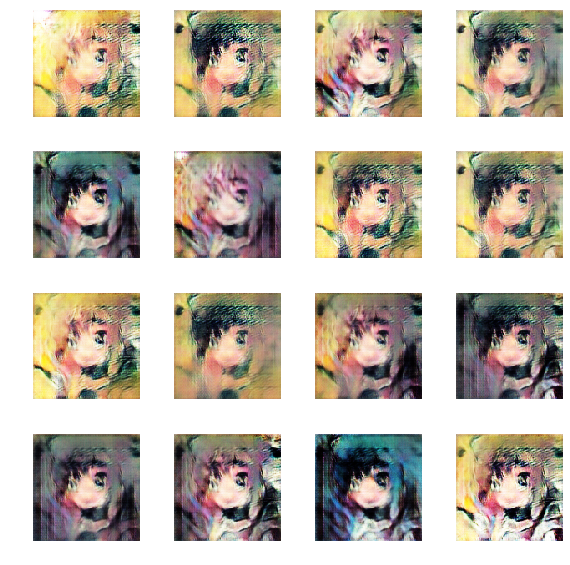

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 96; D loss: 0.2141; G_loss: 9.338; penalty: 0.01896


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 97; D loss: 0.2086; G_loss: 7.772; penalty: 0.01602


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 98; D loss: 0.2337; G_loss: 11.9; penalty: 0.01329


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 99; D loss: 0.3235; G_loss: 8.51; penalty: 0.02204


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 100; D loss: 0.2565; G_loss: 11.34; penalty: 0.01713


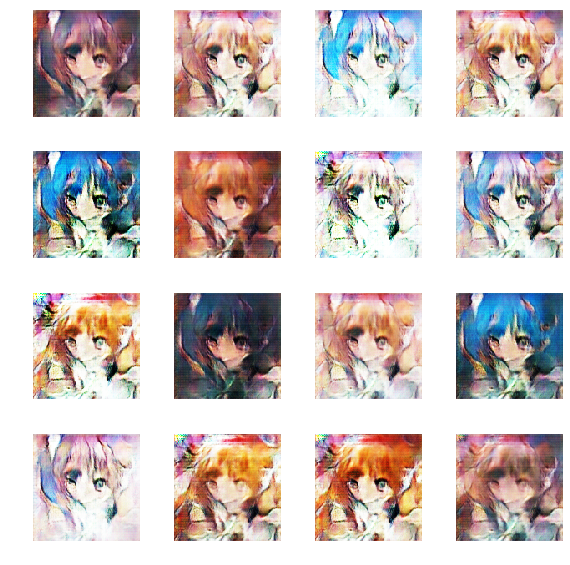

Model saved for epoch 100
Instructions for updating:
Use standard file APIs to delete files with this prefix.


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 101; D loss: 0.12; G_loss: 8.91; penalty: 0.0114


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 102; D loss: 0.1785; G_loss: 7.756; penalty: 0.01263


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 103; D loss: 0.2757; G_loss: 12.51; penalty: 0.01427


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 104; D loss: 0.4351; G_loss: 3.79; penalty: 0.01615


100%|██████████| 94/94 [03:05<00:00,  1.99s/it]


Epoch: 105; D loss: 0.2097; G_loss: 12.43; penalty: 0.0156


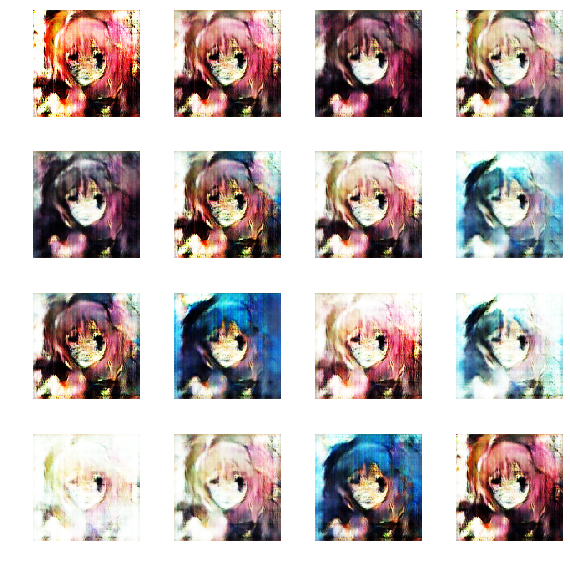

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 106; D loss: 0.259; G_loss: 9.01; penalty: 0.01151


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 107; D loss: 0.6315; G_loss: 12.27; penalty: 0.04878


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 108; D loss: 1.008; G_loss: 26.34; penalty: 0.01748


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 109; D loss: 0.1712; G_loss: 17.84; penalty: 0.01656


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 110; D loss: 0.4008; G_loss: 14.23; penalty: 0.01801


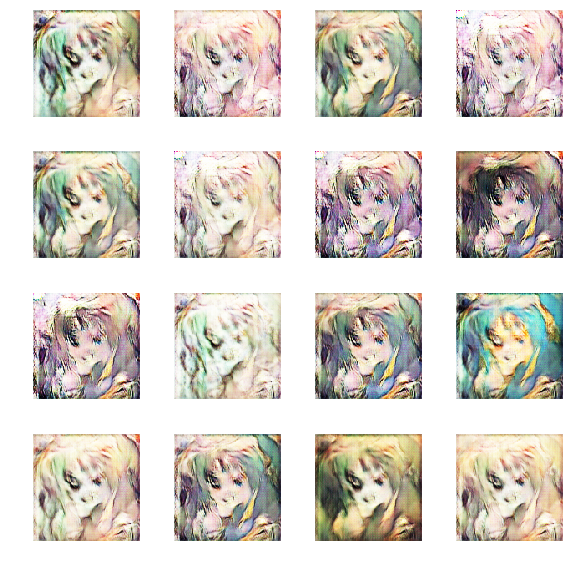

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 111; D loss: 0.1627; G_loss: 13.7; penalty: 0.01523


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 112; D loss: 0.2554; G_loss: 14.38; penalty: 0.0252


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 113; D loss: 0.2577; G_loss: 15.74; penalty: 0.02537


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 114; D loss: 0.2322; G_loss: 17.67; penalty: 0.01553


100%|██████████| 94/94 [03:05<00:00,  1.99s/it]


Epoch: 115; D loss: 0.1649; G_loss: 9.895; penalty: 0.01421


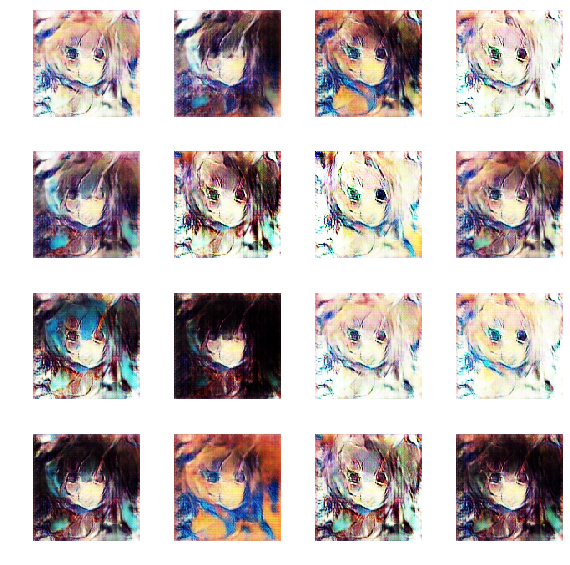

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 116; D loss: 0.126; G_loss: 5.464; penalty: 0.01021


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 117; D loss: 0.2517; G_loss: 13.5; penalty: 0.01648


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 118; D loss: 0.1863; G_loss: 11.93; penalty: 0.008718


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 119; D loss: 0.1404; G_loss: 8.962; penalty: 0.01151


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 120; D loss: 0.1891; G_loss: 11.68; penalty: 0.009917


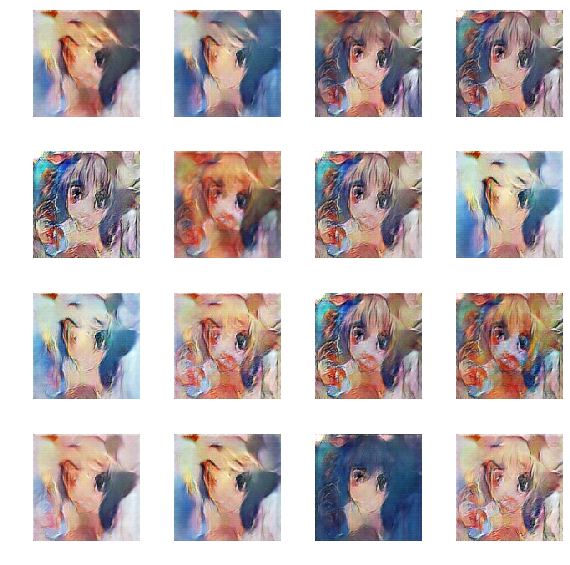

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 121; D loss: 0.2771; G_loss: 17.0; penalty: 0.02661


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 122; D loss: 0.2314; G_loss: 10.6; penalty: 0.01294


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 123; D loss: 0.1373; G_loss: 6.275; penalty: 0.01004


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 124; D loss: 0.4612; G_loss: 22.03; penalty: 0.01113


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 125; D loss: 0.161; G_loss: 10.48; penalty: 0.01363


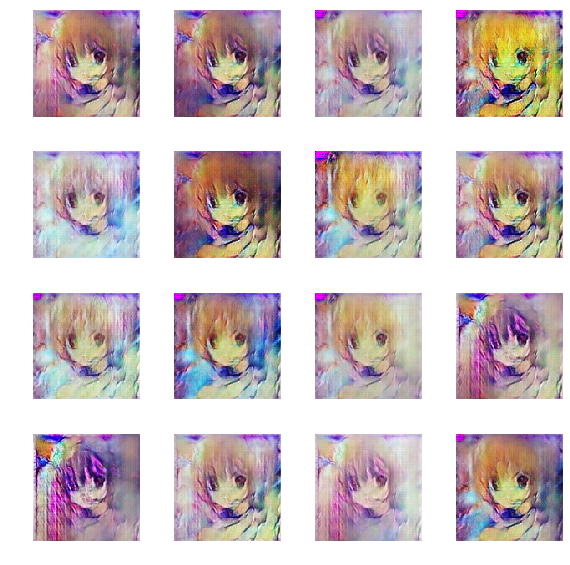

Model saved for epoch 125


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 126; D loss: 0.1929; G_loss: 7.436; penalty: 0.01357


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 127; D loss: 0.2471; G_loss: 14.08; penalty: 0.01308


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 128; D loss: 0.1178; G_loss: 8.932; penalty: 0.01124


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 129; D loss: 0.1335; G_loss: 6.102; penalty: 0.009347


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 130; D loss: 0.1267; G_loss: 7.344; penalty: 0.009145


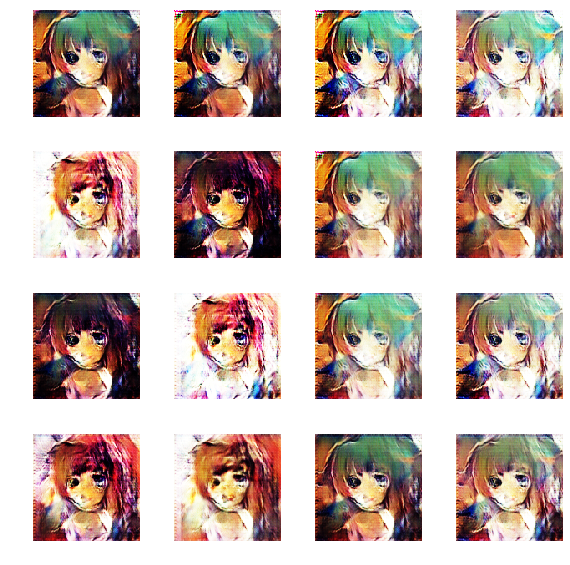

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 131; D loss: 0.2931; G_loss: 13.3; penalty: 0.01598


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 132; D loss: 0.2025; G_loss: 8.574; penalty: 0.01217


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 133; D loss: 0.09941; G_loss: 8.4; penalty: 0.009609


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 134; D loss: 0.1426; G_loss: 8.218; penalty: 0.01346


100%|██████████| 94/94 [03:05<00:00,  1.96s/it]


Epoch: 135; D loss: 0.1481; G_loss: 6.819; penalty: 0.01144


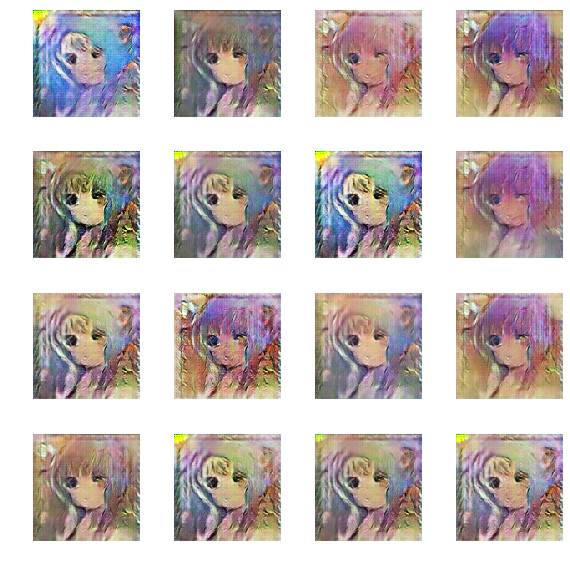

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 136; D loss: 0.348; G_loss: 10.24; penalty: 0.01973


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 137; D loss: 0.7018; G_loss: 31.32; penalty: 0.01273


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 138; D loss: 0.1656; G_loss: 15.44; penalty: 0.01208


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 139; D loss: 0.2049; G_loss: 4.989; penalty: 0.00811


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 140; D loss: 0.2068; G_loss: 8.895; penalty: 0.01316


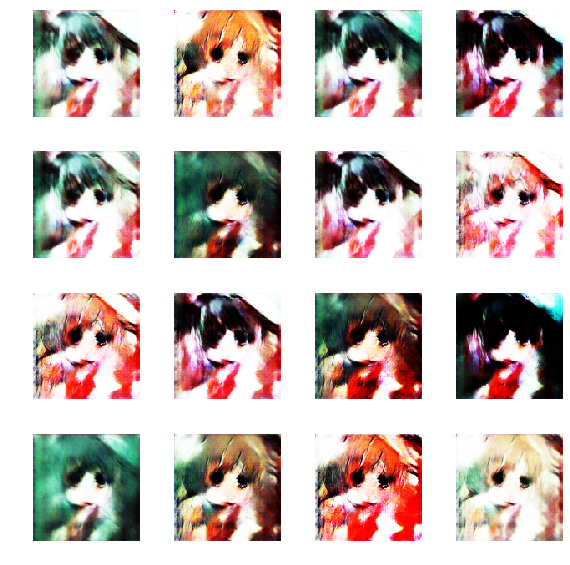

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 141; D loss: 0.1498; G_loss: 9.172; penalty: 0.01215


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 142; D loss: 0.2798; G_loss: 6.122; penalty: 0.01211


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 143; D loss: 0.4121; G_loss: 17.1; penalty: 0.023


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 144; D loss: 0.1609; G_loss: 9.004; penalty: 0.0102


100%|██████████| 94/94 [03:05<00:00,  1.97s/it]


Epoch: 145; D loss: 0.1389; G_loss: 6.857; penalty: 0.01267


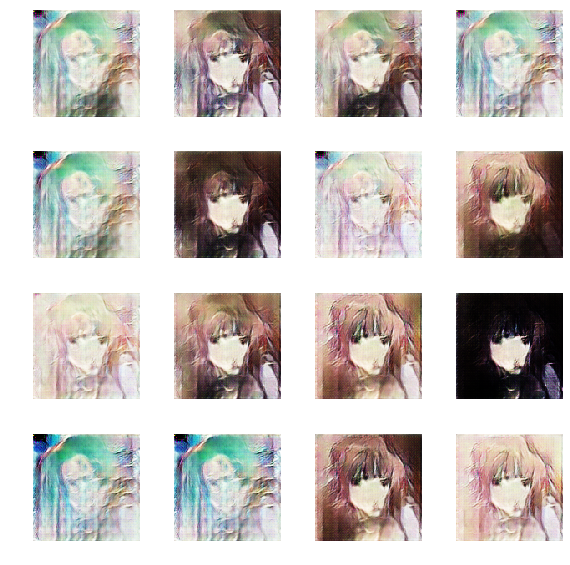

  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 146; D loss: 0.9633; G_loss: 26.27; penalty: 0.01433


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 147; D loss: 0.1313; G_loss: 8.453; penalty: 0.01188


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 148; D loss: 0.1495; G_loss: 8.737; penalty: 0.007866


  0%|          | 0/94 [00:00<?, ?it/s]

Epoch: 149; D loss: 0.2157; G_loss: 11.5; penalty: 0.02124


100%|██████████| 94/94 [03:05<00:00,  1.98s/it]


Epoch: 150; D loss: 0.2029; G_loss: 12.09; penalty: 0.0177


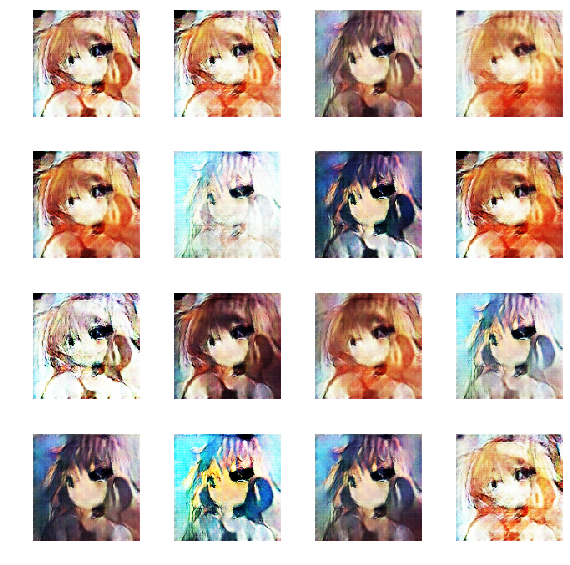

Model saved for epoch 150


 43%|████▎     | 40/94 [01:19<01:45,  1.96s/it]

KeyboardInterrupt: ignored

In [13]:
train(EPOCHS, batch_size=BATCH_SIZE)

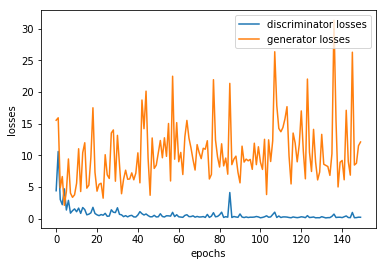

In [20]:
plt.plot(dlosses)
plt.plot(glosses)
plt.xlabel('epochs')
plt.ylabel('losses')
plt.legend(['discriminator losses', 'generator losses'], loc='upper right')
plt.savefig('dcgan_dragan_losses.png')
plt.show()

In [18]:
!zip -r /content/file.zip /content/DCGAN_DRAGAN-images

  adding: content/DCGAN_DRAGAN-images/ (stored 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 40.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 130.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 115.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 75.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 60.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 45.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 85.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 20.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 25.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 35.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 65.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 150.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 120.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-images/epoch 15.png (deflated 0%)
  adding: content/DCGAN_DRAGAN-imag

In [19]:
!zip -r /content/file2.zip /content/model

  adding: content/model/ (stored 0%)
  adding: content/model/DCGAN_DRAGAN-model-100.meta (deflated 93%)
  adding: content/model/DCGAN_DRAGAN-model-150.meta (deflated 93%)
  adding: content/model/DCGAN_DRAGAN-model-50.index (deflated 58%)
  adding: content/model/DCGAN_DRAGAN-model-100.data-00000-of-00001 (deflated 8%)
  adding: content/model/DCGAN_DRAGAN-model-100.index (deflated 58%)
  adding: content/model/DCGAN_DRAGAN-model-150.index (deflated 58%)
  adding: content/model/DCGAN_DRAGAN-model-50.data-00000-of-00001 (deflated 9%)
  adding: content/model/DCGAN_DRAGAN-model-125.data-00000-of-00001 (deflated 8%)
  adding: content/model/DCGAN_DRAGAN-model-75.index (deflated 58%)
  adding: content/model/DCGAN_DRAGAN-model-75.meta (deflated 93%)
  adding: content/model/.ipynb_checkpoints/ (stored 0%)
  adding: content/model/DCGAN_DRAGAN-model-75.data-00000-of-00001 (deflated 8%)
  adding: content/model/DCGAN_DRAGAN-model-125.index (deflated 58%)
  adding: content/model/DCGAN_DRAGAN-model-150.